8. Is there a difference in the number of double faults based on gender? 

Loading Data:

In [3]:
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


folder_path = Path('../data/input/raw_match_parquet')
folder_path1= Path('../data/input/raw_statistics_parquet')

#Away Team Data
all_away_team_dfs = []

for parquet_file in folder_path.glob('away_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'gender', 'full_name', 'country'])
        all_away_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_away_team_dfs:
    away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(away_team_data.shape)
    print(away_team_data.head())
    print(f"Successfully combined {len(all_away_team_dfs)} away team parquet files.")
else:
    print(f"No 'away_team_*.parquet' files found in {folder_path} or no files could be read.")

# Home Team Data
all_home_team_dfs = []

for parquet_file in folder_path.glob('home_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'gender', 'full_name', 'country'])
        all_home_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_home_team_dfs:
    home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(home_team_data.shape)
    print(home_team_data.head())
    print(f"Successfully combined {len(all_home_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")

# statistic Data
statistic_dfs = []

for parquet_file in folder_path1.glob('statistics_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'statistic_name', 'home_value', 'away_value'])
        df = df[df['statistic_name'] == 'double_faults']
        statistic_dfs.append(df)
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")


if statistic_dfs:
    statistic_data = pd.concat(statistic_dfs, ignore_index=True)
    print("\n--- Combined statistic DataFrame Info ---")
    print(statistic_data.shape)
    print(statistic_data.head())
    print(f"Successfully combined {len(statistic_dfs)} statistic parquet files.")
else:
    print(f"No 'statistic_*.parquet' files found in {folder_path} or no files could be read.")

Successfully read away_team_11998445.parquet
Successfully read away_team_11998446.parquet
Successfully read away_team_11998447.parquet
Successfully read away_team_11998448.parquet
Successfully read away_team_11998449.parquet
Successfully read away_team_11998450.parquet
Successfully read away_team_11998451.parquet
Successfully read away_team_11998452.parquet
Successfully read away_team_11998453.parquet
Successfully read away_team_11998454.parquet
Successfully read away_team_11998455.parquet
Successfully read away_team_11998456.parquet
Successfully read away_team_11998457.parquet
Successfully read away_team_11998458.parquet
Successfully read away_team_11998459.parquet
Successfully read away_team_11998663.parquet
Successfully read away_team_11998664.parquet
Successfully read away_team_11998666.parquet
Successfully read away_team_11998667.parquet
Successfully read away_team_11998670.parquet
Successfully read away_team_11998671.parquet
Successfully read away_team_11998672.parquet
Successful

Double Fualts by Gender:


--- Combined statistic DataFrame Info ---
(37215, 4)
   match_id statistic_name  home_value  away_value
0  11998445  double_faults           2           7
1  11998445  double_faults           1           2
2  11998445  double_faults           1           2
3  11998445  double_faults           0           3
4  11998446  double_faults           2           1
Successfully combined 11393 statistic parquet files.


C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_9588\4079576239.py:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=combined_df, x='gender', y='double_faults',


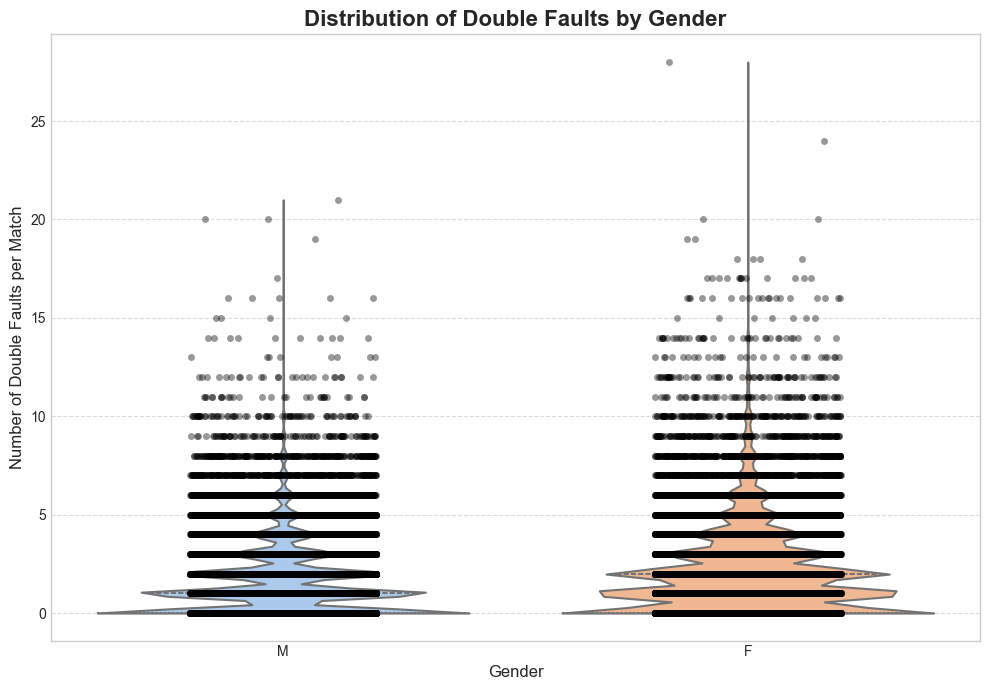


--- Descriptive Statistics for Double Faults by Gender ---
          count      mean       std  min  25%  50%  75%   max
gender                                                       
F       30950.0  2.107981  2.249022  0.0  0.0  2.0  3.0  28.0
M       40166.0  1.599064  1.801070  0.0  0.0  1.0  2.0  21.0

--- Independent Two-Sample T-Test ---
T-statistic: -32.5674
P-value: 0.0000
The difference in the mean number of double faults between genders is statistically significant.


In [13]:
statistic_data = None 
if statistic_dfs:
    statistic_data = pd.concat(statistic_dfs, ignore_index=True)
    print("\n--- Combined statistic DataFrame Info ---")
    print(statistic_data.shape)
    print(statistic_data.head())
    print(f"Successfully combined {len(statistic_dfs)} statistic parquet files.")
else:
    print(f"No 'statistic_*.parquet' files found in {folder_path1} or no files could be read.")
    
if statistic_data is not None:

    double_faults_data = statistic_data[statistic_data['statistic_name'] == 'double_faults'].copy()

    if 'away_team_data' in locals() and 'home_team_data' in locals():
        double_faults_data = pd.merge(double_faults_data, home_team_data[['match_id', 'gender']], on='match_id', how='left', suffixes=('_stat', '_home'))
        
        double_faults_data = pd.merge(double_faults_data, away_team_data[['match_id', 'gender']], on='match_id', how='left', suffixes=('_home', '_away'))
        double_faults_data['gender'] = double_faults_data['gender_home'].fillna(double_faults_data['gender_away'])
        double_faults_data.drop(columns=['gender_home', 'gender_away'], inplace=True)
        
    else:
        print("Warning: Could not find both home and away team data. Skipping analysis.")
        exit()

home_df = double_faults_data[['match_id', 'gender', 'home_value']].copy()
home_df['team'] = 'home'
home_df = home_df.rename(columns={'home_value': 'double_faults'})

away_df = double_faults_data[['match_id', 'gender', 'away_value']].copy()
away_df['team'] = 'away'
away_df = away_df.rename(columns={'away_value': 'double_faults'})

combined_df = pd.concat([home_df, away_df], ignore_index=True)

combined_df = combined_df.dropna(subset=['double_faults', 'gender'])

combined_df['double_faults'] = pd.to_numeric(combined_df['double_faults'], errors='coerce')


plt.style.use('seaborn-v0_8-whitegrid')
plt.figure(figsize=(10, 7))
  
sns.violinplot(data=combined_df, x='gender', y='double_faults', 
    palette='pastel', inner='quartile', cut=0, linewidth=1.5)

sns.stripplot(data=combined_df, x='gender', y='double_faults', 
    color='black', alpha=0.4, jitter=0.2)

plt.title('Distribution of Double Faults by Gender', fontsize=16, fontweight='bold')
plt.xlabel('Gender', fontsize=12)
plt.ylabel('Number of Double Faults per Match', fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Distribution of Double Faults by Gender.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

print("\n--- Descriptive Statistics for Double Faults by Gender ---")
print(combined_df.groupby('gender')['double_faults'].describe())

male_df = combined_df[combined_df['gender'] == 'M']['double_faults']
female_df = combined_df[combined_df['gender'] == 'F']['double_faults']

from scipy import stats
t_stat, p_value = stats.ttest_ind(male_df, female_df, equal_var=False, nan_policy='omit')

print("\n--- Independent Two-Sample T-Test ---")
print(f"T-statistic: {t_stat:.4f}")
print(f"P-value: {p_value:.4f}")

if p_value < 0.05:
    print("The difference in the mean number of double faults between genders is statistically significant.")
else:
    print("The difference is not statistically significant.")

Double Faults by Country:

In [14]:
if statistic_data is not None and home_team_data is not None and away_team_data is not None:
    double_faults_data = statistic_data[statistic_data['statistic_name'] == 'double_faults'].copy()
  
    double_faults_data = pd.merge(double_faults_data, home_team_data[['match_id', 'gender', 'country']], on='match_id', how='left', suffixes=('_stat', '_home'))
    double_faults_data = pd.merge(double_faults_data, away_team_data[['match_id', 'gender', 'country']], on='match_id', how='left', suffixes=('_home', '_away'))
    double_faults_data['gender'] = double_faults_data['gender_home'].fillna(double_faults_data['gender_away'])
    double_faults_data['country'] = double_faults_data['country_home'].fillna(double_faults_data['country_away'])
    double_faults_data.drop(columns=['gender_home', 'gender_away', 'country_home', 'country_away'], inplace=True)
 
    home_df = double_faults_data[['match_id', 'gender', 'country', 'home_value']].copy()
    home_df = home_df.rename(columns={'home_value': 'double_faults'})
    
    away_df = double_faults_data[['match_id', 'gender', 'country', 'away_value']].copy()
    away_df = away_df.rename(columns={'away_value': 'double_faults'})
    
    combined_df = pd.concat([home_df, away_df], ignore_index=True)

    combined_df = combined_df.dropna(subset=['double_faults', 'gender', 'country'])
    combined_df['double_faults'] = pd.to_numeric(combined_df['double_faults'], errors='coerce')
    combined_df = combined_df.dropna(subset=['double_faults'])
    
    print("\n--- Final Combined Player DataFrame Info ---")
    print(combined_df.shape)
    print(combined_df.head())
    
else:
    print("Warning: One or more required DataFrames (statistic_data, home_team_data, away_team_data) were not created. Skipping analysis.")


--- Final Combined Player DataFrame Info ---
(71116, 4)
   match_id gender country  double_faults
0  11998445      M  France              2
1  11998445      M  France              1
2  11998445      M  France              1
3  11998445      M  France              0
4  11998446      M  France              2


C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_9588\1606985498.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=country_avg_df.head(10), x='double_faults', y='country', palette='mako')


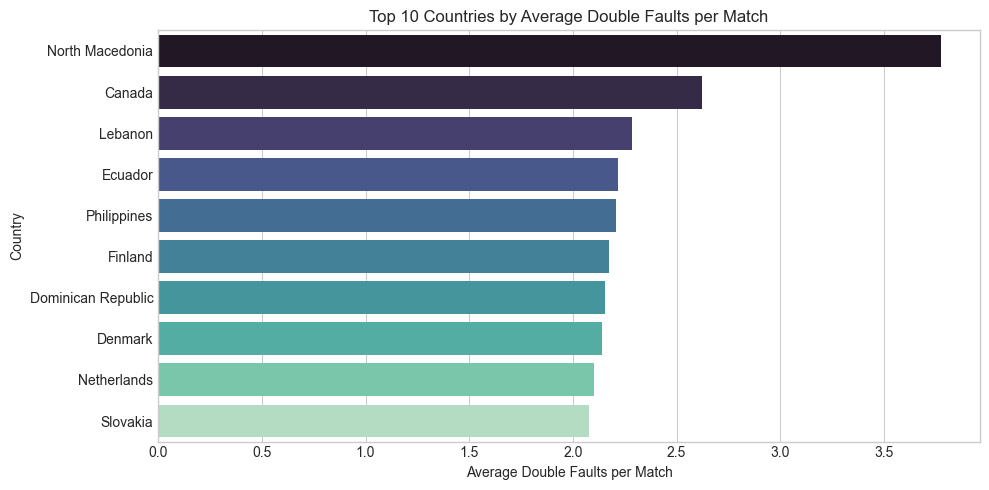

In [23]:
min_matches = 50
country_counts = combined_df.groupby('country')['double_faults'].count()
countries_with_enough_data = country_counts[country_counts >= min_matches].index

filtered_player_df = combined_df[combined_df['country'].isin(countries_with_enough_data)].copy()

country_avg_df = filtered_player_df.groupby('country')['double_faults'].mean().sort_values(ascending=False).reset_index()

plt.figure(figsize=(10, 5))
sns.barplot(data=country_avg_df.head(10), x='double_faults', y='country', palette='mako')
plt.title('Top 10 Countries by Average Double Faults per Match')
plt.xlabel('Average Double Faults per Match')
plt.ylabel('Country')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Top 10 Countries by Average Double Faults per Match.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

Most / Least Double-Faulting Players

In [19]:
if statistic_data is not None and home_team_data is not None and away_team_data is not None:
    double_faults_stats = statistic_data[statistic_data['statistic_name'] == 'double_faults'].copy()

    home_player_df = pd.merge(home_team_data, double_faults_stats, on='match_id', how='inner')
    home_player_df = home_player_df.rename(columns={'home_value': 'double_faults'})
    home_player_df = home_player_df[['full_name', 'country', 'gender', 'double_faults']]

    away_player_df = pd.merge(away_team_data, double_faults_stats, on='match_id', how='inner')
    away_player_df = away_player_df.rename(columns={'away_value': 'double_faults'})
    away_player_df = away_player_df[['full_name', 'country', 'gender', 'double_faults']]

    combined_df = pd.concat([home_player_df, away_player_df], ignore_index=True)

    combined_df = combined_df.dropna(subset=['double_faults'])
    combined_df['double_faults'] = pd.to_numeric(combined_df['double_faults'], errors='coerce')
    combined_df = combined_df.dropna(subset=['double_faults'])
    
    print("\n--- Final Combined Player DataFrame Info ---")
    print(combined_df.shape)
    print(combined_df.head())
else:
    print("Warning: One or more required DataFrames were not created. Skipping analysis.")


--- Final Combined Player DataFrame Info ---
(65120, 4)
             full_name country gender  double_faults
0       Cazaux, Arthur  France      M              2
1       Cazaux, Arthur  France      M              1
2       Cazaux, Arthur  France      M              1
3       Cazaux, Arthur  France      M              0
4  Lestienne, Constant  France      M              2


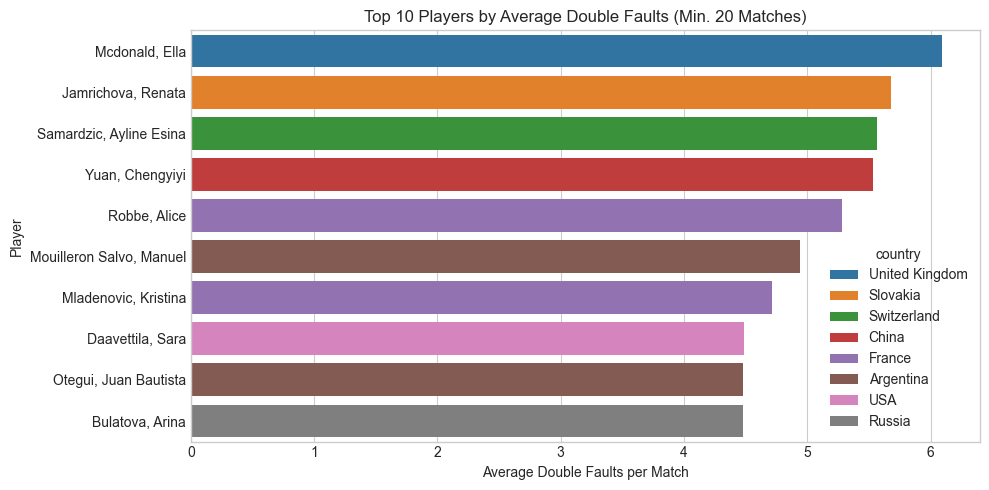

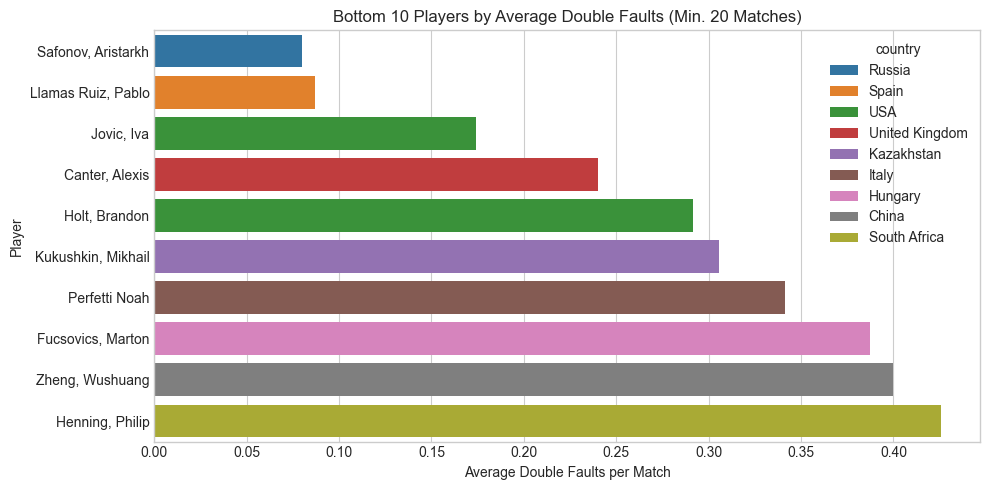

In [21]:
player_avg_df = combined_df.groupby(['full_name', 'country']).agg(
    double_faults_avg=('double_faults', 'mean'),
    match_count=('double_faults', 'count')
).reset_index()

min_matches = 20
filtered_player_avg = player_avg_df[player_avg_df['match_count'] >= min_matches]

top_players = filtered_player_avg.sort_values(by='double_faults_avg', ascending=False).head(10)
bottom_players = filtered_player_avg.sort_values(by='double_faults_avg', ascending=True).head(10)

plt.figure(figsize=(10, 5))
sns.barplot(data=top_players, x='double_faults_avg', y='full_name', hue='country', dodge=False)
plt.title('Top 10 Players by Average Double Faults (Min. 20 Matches)')
plt.xlabel('Average Double Faults per Match')
plt.ylabel('Player')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Top 10 Players by Average Double Faults (Min. 20 Matches).png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

plt.figure(figsize=(10, 5))
sns.barplot(data=bottom_players, x='double_faults_avg', y='full_name', hue='country', dodge=False)
plt.title('Bottom 10 Players by Average Double Faults (Min. 20 Matches)')
plt.xlabel('Average Double Faults per Match')
plt.ylabel('Player')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Bottom 10 Players by Average Double Faults (Min. 20 Matches).png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()